## 1. Setup and Data Acquisition

**Installation of Dependencies**

This cell uses the `%pip` magic command to install the `kagglehub` library, specifically with the `[pandas-datasets]` extra. This library is essential for easily downloading datasets hosted on Kaggle, such as the CelebA dataset used in this notebook.

In [1]:
%pip install kagglehub[pandas-datasets]

**Import Libraries**

This cell imports all the necessary Python libraries for the project:

*   **Standard Libraries:** `os` (for file path operations), `random` (for sampling images), and `PIL.Image` (for image handling).
*   **Visualization:** `matplotlib.pyplot` (for plotting images).
*   **Data Handling:** `kagglehub` (for dataset access).
*   **Deep Learning:** `tensorflow` and `numpy` (for numerical operations and model building).
*   **Keras Components:** Various layers (`Input`, `Dense`, `Reshape`, `Conv2DTranspose`, `Conv2D`, `BatchNormalization`, `LeakyReLU`, etc.) and modules (`Model`, `Adam`) from `tensorflow.keras` for constructing and training the Generative Adversarial Network (GAN).

In [2]:
import os
import random
from PIL import Image
import matplotlib.pyplot as plt
import kagglehub
from kagglehub import KaggleDatasetAdapter
import tensorflow as tf
import numpy as np
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Dropout, Layer, LeakyReLU, Conv2DTranspose, Add, Conv2D, MaxPool2D, Flatten, InputLayer, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

**Dataset Download**

This cell downloads the **CelebA (CelebFaces Attributes)** dataset from Kaggle using the `kagglehub.dataset_download` function. The downloaded path is stored in the `path` variable, which will be used to locate the image files for training the GAN.

In [3]:
path = kagglehub.dataset_download("jessicali9530/celeba-dataset")
print("Downloaded to:", path)

Using Colab cache for faster access to the 'celeba-dataset' dataset.
Downloaded to: /kaggle/input/celeba-dataset


**Sample Image Visualization**

This cell performs the following steps to verify the dataset download and visualize a sample of the images:

1.  **Sets `image_dir`:** Constructs the full path to the directory containing the CelebA image files.
2.  **Lists Files:** Gets a list of all `.jpg` image files in the directory.
3.  **Samples Images:** Randomly selects 9 image file names.
4.  **Plots Images:** Iterates through the sampled files, loads each image using `PIL.Image`, and displays them in a 3x3 grid using `matplotlib.pyplot`.

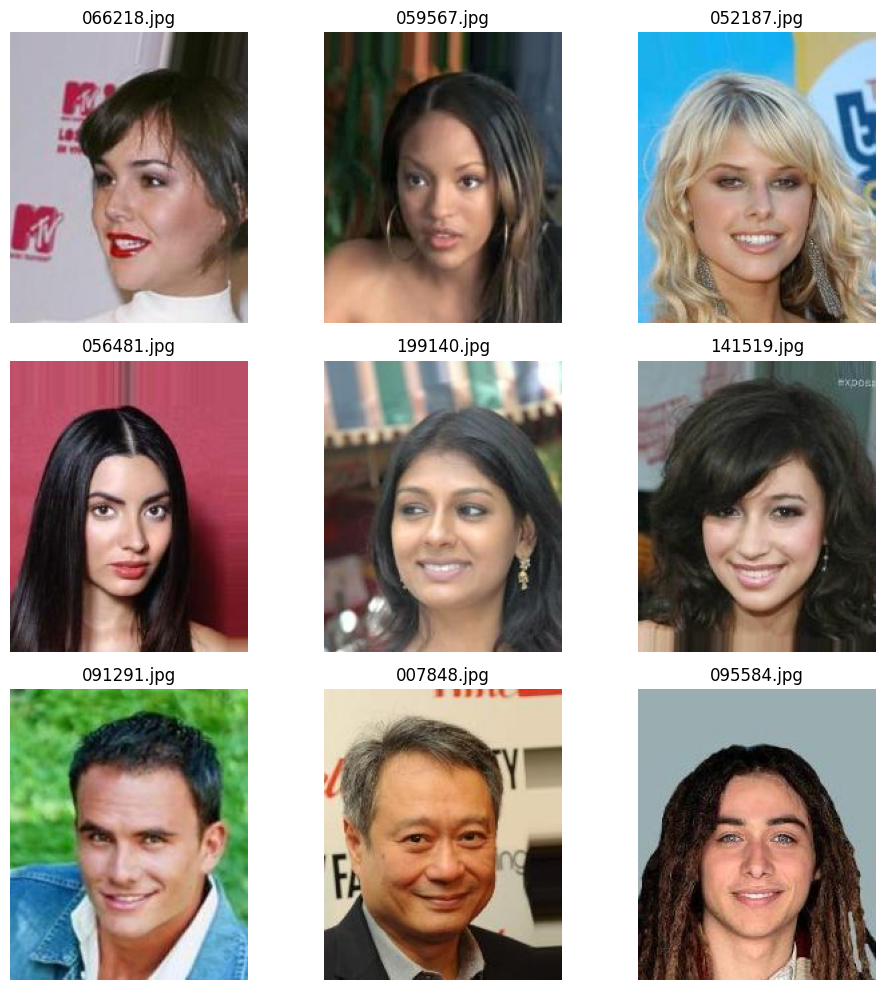

In [4]:
image_dir = os.path.join(path, "img_align_celeba/img_align_celeba")

image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(".jpg")]

num_images = 9
sample_files = random.sample(image_files, num_images)

plt.figure(figsize=(10, 10))
for i, file in enumerate(sample_files):
    img_path = os.path.join(image_dir, file)
    img = Image.open(img_path)

    plt.subplot(3, 3, i + 1)
    plt.imshow(img)
    plt.axis("off")
    plt.title(file)

plt.tight_layout()
plt.show()


## 2. Configuration and Data Preprocessing

**Hyperparameter and Configuration Setup**

This cell defines key configuration variables (hyperparameters) for the GAN training process:

*   `batch_size = 128`: The number of images processed in one training step.
*   `image_shape = (64, 64, 3)`: The target resolution (64x64 pixels) and color channels (3 for RGB) for the input images.
*   `lr = 2e-4`: The learning rate for the optimizers.
*   `l_dim = 100`: The dimension of the latent space (the size of the random noise vector fed to the Generator).

In [5]:
batch_size = 128
image_shape = (64,64, 3)
lr = 2e-4
l_dim = 100

**Load Raw Data**

This cell uses the `tf.keras.preprocessing.image_dataset_from_directory` utility to efficiently load the images from the specified directory (`image_dir`).

*   `label_mode=None`: Indicates that the images are not being used for a classification task, so no labels are needed.
*   `batch_size` and `image_size`: Configures the data to be loaded in batches and resized to the target 64x64 resolution.

In [6]:
raw_data = tf.keras.preprocessing.image_dataset_from_directory(
    image_dir,
    label_mode=None,
    batch_size=batch_size,
    image_size=(image_shape[0], image_shape[1])
)

Found 202599 files.


**Image Preprocessing Function**

This function defines the necessary preprocessing steps for the images before they are fed into the GAN models:

1.  **Type Casting:** Converts the image data to `tf.float32`.
2.  **Normalization:** Scales the pixel values from the original range of [0, 255] to the range of **[-1, 1]**. This is a standard practice for GANs, especially when the Generator uses a `tanh` activation function in its final layer.

In [7]:
def preprocess_image(image):
    image = tf.cast(image, tf.float32)
    image = (image / 127.5) - 1.0
    return image

**Create Training Data Pipeline**

This cell constructs the final optimized `tf.data.Dataset` pipeline for training:

*   `.map(preprocess_image)`: Applies the normalization function to every image.
*   `.unbatch()`: Converts the batched data back to individual elements.
*   `.shuffle(...)`: Shuffles the dataset to ensure random sampling of images in each epoch.
*   `.batch(...)`: Re-batches the shuffled data with `drop_remainder=True` to ensure all batches have the same size, which is often required for training deep learning models.
*   `.prefetch(tf.data.AUTOTUNE)`: Optimizes data loading by prefetching batches in the background, improving training speed.

In [8]:
train_data = (
    raw_data
    .map(preprocess_image)
    .unbatch()
    .shuffle(buffer_size=1024, reshuffle_each_iteration = True)
    .batch(batch_size, drop_remainder=True)
    .prefetch(tf.data.AUTOTUNE)
)

**Visualize Preprocessed Data**

This cell visualizes a small sample of the images from the newly created `train_data` pipeline to confirm that the preprocessing (normalization) was applied correctly.

*   `train_data.take(1)`: Fetches a single batch of data.
*   `images[i].numpy() * 0.5 + 0.5`: The images are denormalized from the [-1, 1] range back to the [0, 1] range for correct display by `matplotlib.pyplot.imshow`.

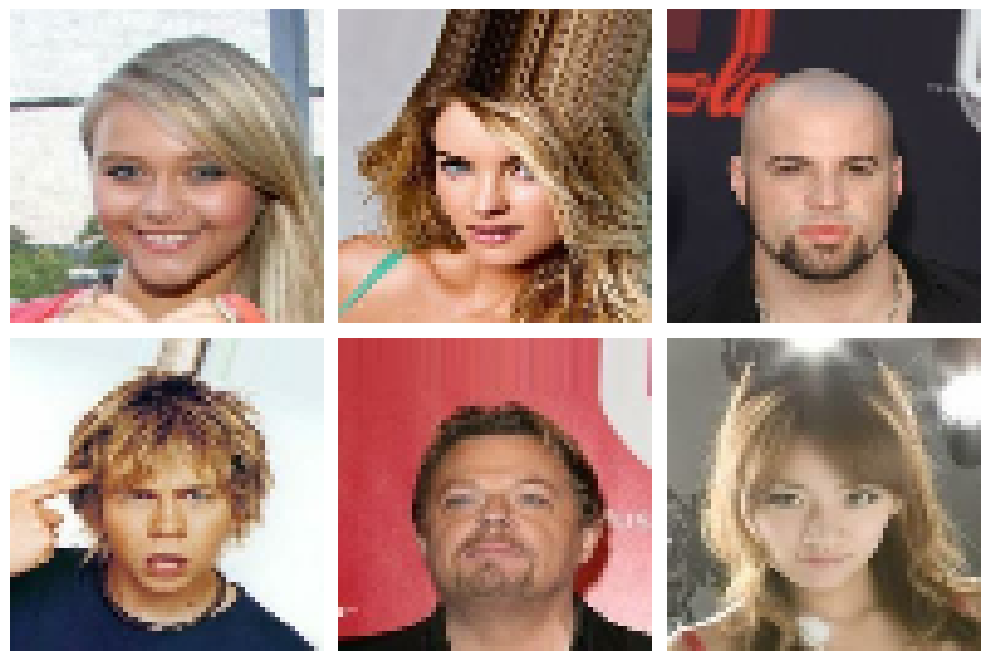

In [9]:
plt.figure(figsize=(10, 10))
n = 6

for images in train_data.take(1):
    for i in range(n):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow((images[i].numpy() * 0.5 + 0.5))
        plt.axis("off")

plt.tight_layout()
plt.show()

## 3. Model Architecture (Generator and Discriminator)

**Generator Model Definition**

This cell defines the **Generator** model, which is responsible for creating realistic images from random noise (latent vector).

*   **Input:** Takes a noise vector of size `l_dim` (100).
*   **Initial Layers:** A `Dense` layer and a `Reshape` layer transform the 1D noise vector into a 4x4 feature map.
*   **Upsampling:** Uses a series of `Conv2DTranspose` (deconvolutional) layers to upsample the feature map from 4x4 to 8x8, 16x16, 32x32, and finally to the target 64x64 image size.
*   **Normalization/Activation:** Each upsampling block uses `BatchNormalization` and `LeakyReLU` activation for stable training.
*   **Output:** The final layer uses `tanh` activation, which is suitable for outputting images normalized to the [-1, 1] range.

In [10]:
generator = tf.keras.Sequential([
    Input(shape = (l_dim,)),
    Dense(4*4*l_dim),
    Reshape((4,4,l_dim)),

    Conv2DTranspose(512, kernel_size = 4, strides = 2, padding = "same"),
    BatchNormalization(),
    LeakyReLU(0.2),

    Conv2DTranspose(256, kernel_size = 4, strides = 2, padding = "same"),
    BatchNormalization(),
    LeakyReLU(0.2),

    Conv2DTranspose(128, kernel_size = 4, strides = 2, padding = "same"),
    BatchNormalization(),
    LeakyReLU(0.2),

    Conv2DTranspose(3, kernel_size = 4, strides = 2, padding="same", activation = tf.keras.activations.tanh)
], name = 'generator')

In [11]:
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 1600)           │       161,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 4, 4, 100)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 8, 8, 512)      │       819,712 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 8, 8, 512)      │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 16, 16, 256)    │     2,097,408 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 16, 16, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 32, 32, 128)    │       524,416 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 32, 32, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_3              │ (None, 64, 64, 3)      │         6,147 │
│ (Conv2DTranspose)               │                        │               │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,612,867 (13.78 MB)

 Trainable params: 3,611,075 (13.78 MB)

 Non-trainable params: 1,792 (7.00 KB)

**Discriminator Model Definition**

This cell defines the **Discriminator** model, which acts as a binary classifier to distinguish between real images (from the dataset) and fake images (generated by the Generator).

*   **Input:** Takes an image of shape 64x64x3.
*   **Downsampling:** Uses a series of `Conv2D` layers with `strides=2` to progressively downsample the image (from 64x64 to 32x32, 16x16, 8x8, and finally a 3x3 feature map).
*   **Normalization/Activation:** Each downsampling block uses `BatchNormalization` and `LeakyReLU` activation.
*   **Output:** The final layers (`Flatten` and `Dense(1)`) output a single value between 0 and 1 using a `sigmoid` activation, representing the probability that the input image is real.

In [12]:
discriminator = tf.keras.Sequential([
    Input(shape = (image_shape[0], image_shape[1], 3)),

    Conv2D(64, kernel_size = 4, strides = 2, padding = "same"),
    LeakyReLU(0.2),

    Conv2D(128, kernel_size = 4, strides = 2, padding = "same"),
    BatchNormalization(),
    LeakyReLU(0.2),

    Conv2D(256, kernel_size = 4, strides = 2, padding = "same"),
    BatchNormalization(),
    LeakyReLU(0.2),

    Conv2D(1, kernel_size = 4, strides = 2, padding = "valid"),
    Flatten(),
    Dense(1, activation = 'sigmoid')
], name = 'discriminator')

In [13]:
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 32, 32, 64)     │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 16, 16, 128)    │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 8, 8, 256)      │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 8, 8, 256)      │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 8, 8, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 3, 3, 1)        │         4,097 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 9)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │            10 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 664,523 (2.53 MB)

 Trainable params: 663,755 (2.53 MB)

 Non-trainable params: 768 (3.00 KB)

## 4. GAN Training Implementation

**Custom GAN Model Class**

This cell defines a custom `GAN` class that inherits from `tf.keras.Model` to manage the coupled training of the Generator and Discriminator. This is the core logic for the GAN training loop.

*   **`__init__`:** Initializes the model with the separate `discriminator` and `generator` models.
*   **`compile`:** Sets up separate optimizers (`d_optimizer`, `g_optimizer`) and a shared `loss` function (likely Binary Cross-Entropy) for both models, and initializes metrics to track the losses.
*   **`train_step`:** Overrides the standard Keras training step to implement the alternating GAN training process:
    1.  **Discriminator Training:** Generates fake images, creates noisy labels for both real (close to 1) and fake (close to 0) images (label smoothing), calculates the combined loss, and updates only the Discriminator's weights.
    2.  **Generator Training:** Generates new fake images, assigns them the 'real' label (misleading labels), calculates the loss (how well the Generator fools the Discriminator), and updates only the Generator's weights.
    3.  **Metrics:** Updates and returns the average loss metrics for both models.

In [ ]:
class GAN(tf.keras.Model):
  def __init__(self, discriminator, generator):
    super(GAN, self).__init__()
    self.discriminator = discriminator
    self.generator = generator

  def compile(self, d_optimizer, g_optimizer, loss):
    super(GAN, self).compile()
    self.d_optimizer = d_optimizer
    self.g_optimizer = g_optimizer
    self.loss = loss
    self.d_loss_metric = tf.keras.metrics.Mean(name="d_loss")
    self.g_loss_metric = tf.keras.metrics.Mean(name="g_loss")

  @property
  def metrics(self):
    return [self.d_loss_metric, self.g_loss_metric]

  def train_step(self, real_images):
    batch_size = tf.shape(real_images)[0]
    noise = tf.random.normal(shape = (batch_size, l_dim))

    fake_images = self.generator(noise)
    real_label = tf.ones((batch_size, 1)) + 0.25 * tf.random.uniform((batch_size, 1), minval=-1, maxval=1)
    fake_label = tf.zeros((batch_size, 1))  + 0.25 * tf.random.uniform((batch_size, 1))

    with tf.GradientTape() as recorder:
      real_output = self.discriminator(real_images)
      d_loss_real = self.loss(real_label, real_output)
      fake_output = self.discriminator(fake_images)
      d_loss_fake = self.loss(fake_label, fake_output)
      d_loss = d_loss_real + d_loss_fake

    grads = recorder.gradient(d_loss, self.discriminator.trainable_weights)
    self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_weights))



    noise = tf.random.normal(shape = (batch_size, l_dim))
    misleading_labels = tf.ones((batch_size, 1))

    with tf.GradientTape() as recorder:
      fake_output = self.discriminator(self.generator(noise))
      g_loss = self.loss(misleading_labels, fake_output)

    grads = recorder.gradient(g_loss, self.generator.trainable_weights)
    self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_weights))


    self.d_loss_metric.update_state(d_loss)
    self.g_loss_metric.update_state(g_loss)

    return {
        "d_loss": self.d_loss_metric.result(),
        "g_loss": self.g_loss_metric.result(),
    }




**Instantiate and Compile GAN**

This cell instantiates the custom `GAN` model and compiles it with the necessary components:

*   **Optimizers:** Uses the `Adam` optimizer for both the Discriminator and Generator, with the configured learning rate (`lr`) and a `beta_1` value of 0.5, which is a common setting for DCGANs (Deep Convolutional GANs).
*   **Loss Function:** Uses `BinaryCrossentropy` as the loss function, which is standard for the binary classification task performed by the Discriminator.

In [15]:
gan = GAN(discriminator=discriminator, generator=generator)
gan.compile(
    d_optimizer=Adam(learning_rate=lr, beta_1=0.5),
    g_optimizer=Adam(learning_rate=lr, beta_1=0.5),
    loss=tf.keras.losses.BinaryCrossentropy(),
)

**Visualizing Progress with a Custom Callback**

To monitor our GAN's progress during its long training, we can't just look at the loss numbers; we need to *see* the images it's creating.

We define a custom **Keras Callback** named `GANMonitor`. A callback is an object that Keras will automatically call at different points during the training process.

Our `GANMonitor` class does its main work in the `on_epoch_end` function, which, as the name suggests, runs automatically at the end of every single epoch.

Here's what it does:

1.  **Generates Noise**: It creates a batch of 36 random noise vectors using `tf.random.normal`.
2.  **Generates Images**: It feeds this noise to the model's generator (`self.model.generator`) to produce 36 new, fake images.
3.  **Plots a Grid**: It creates a large 6x6 `matplotlib` grid to display all 36 images.
4.  **Denormalizes Images**: The generator's output uses the `tanh` activation, which produces pixel values in the range `[-1, 1]`. To display them, we must denormalize them back to the standard `[0, 1]` image range using the formula `(image + 1) / 2`.
5.  **Saves the Figure**: It creates a directory named `gen/` and saves the 6x6 grid as a PNG file (e.g., `gen/image_in_epoch_10.png`), giving us a permanent record of training.
6.  **Displays Output**: `plt.show()` prints the image grid directly in our notebook, so we get immediate visual feedback after each epoch.

This is the most effective way to watch our generator learn and see when its output has become stable or high-quality.

In [16]:
class GANMonitor(tf.keras.callbacks.Callback):
  def __init__(self, latent_dim = 100):
    self.latent_dim = latent_dim

  def on_epoch_end(self, epoch, logs=None):
    n = 6
    k = 0
    out = self.model.generator(tf.random.normal(shape = (36, self.latent_dim)))
    plt.figure(figsize=(16, 16))
    for i in range(n):
      for j in range(n):
        ax = plt.subplot(n, n, k+1)
        plt.imshow((out[k] + 1) / 2,)
        plt.axis("off")
        k += 1
    os.makedirs('gen', exist_ok=True)
    plt.savefig('gen/image_in_epoch_{}.png'.format(epoch))
    plt.show()

Epoch 1/100
   1582/Unknown 294s 173ms/step - d_loss: 1.0853 - g_loss: 0.9903

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:160: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


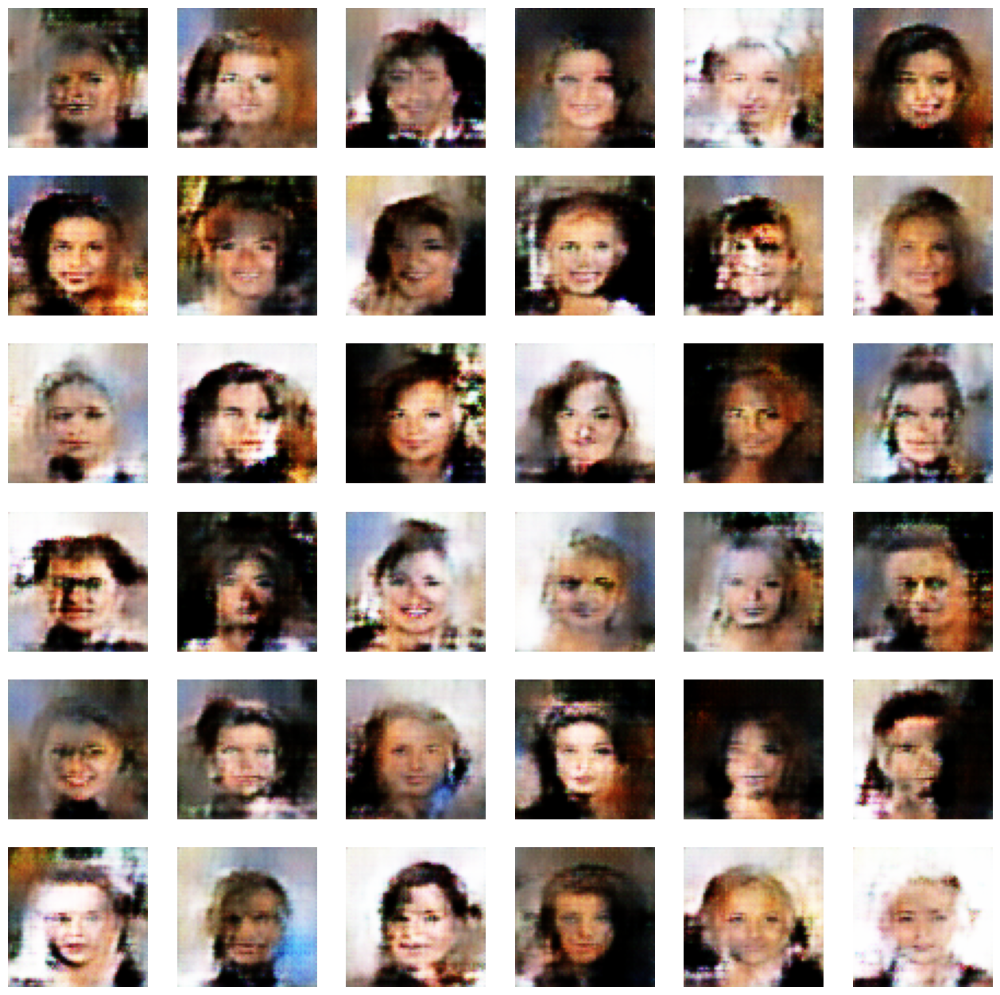

1582/1582 ━━━━━━━━━━━━━━━━━━━━ 296s 175ms/step - d_loss: 1.0854 - g_loss: 0.9903
Epoch 2/100
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 1.1765 - g_loss: 0.9056

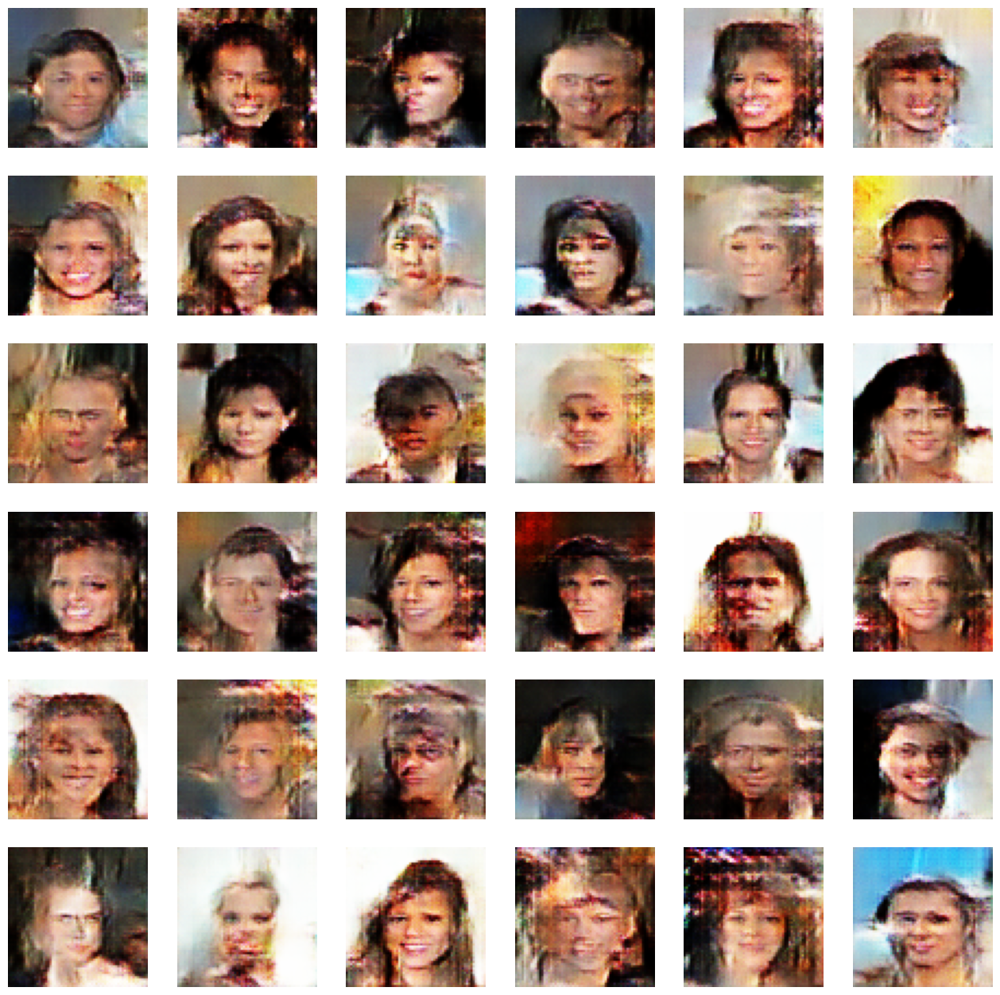

1582/1582 ━━━━━━━━━━━━━━━━━━━━ 279s 176ms/step - d_loss: 1.1765 - g_loss: 0.9056
Epoch 3/100
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 1.2122 - g_loss: 0.8480

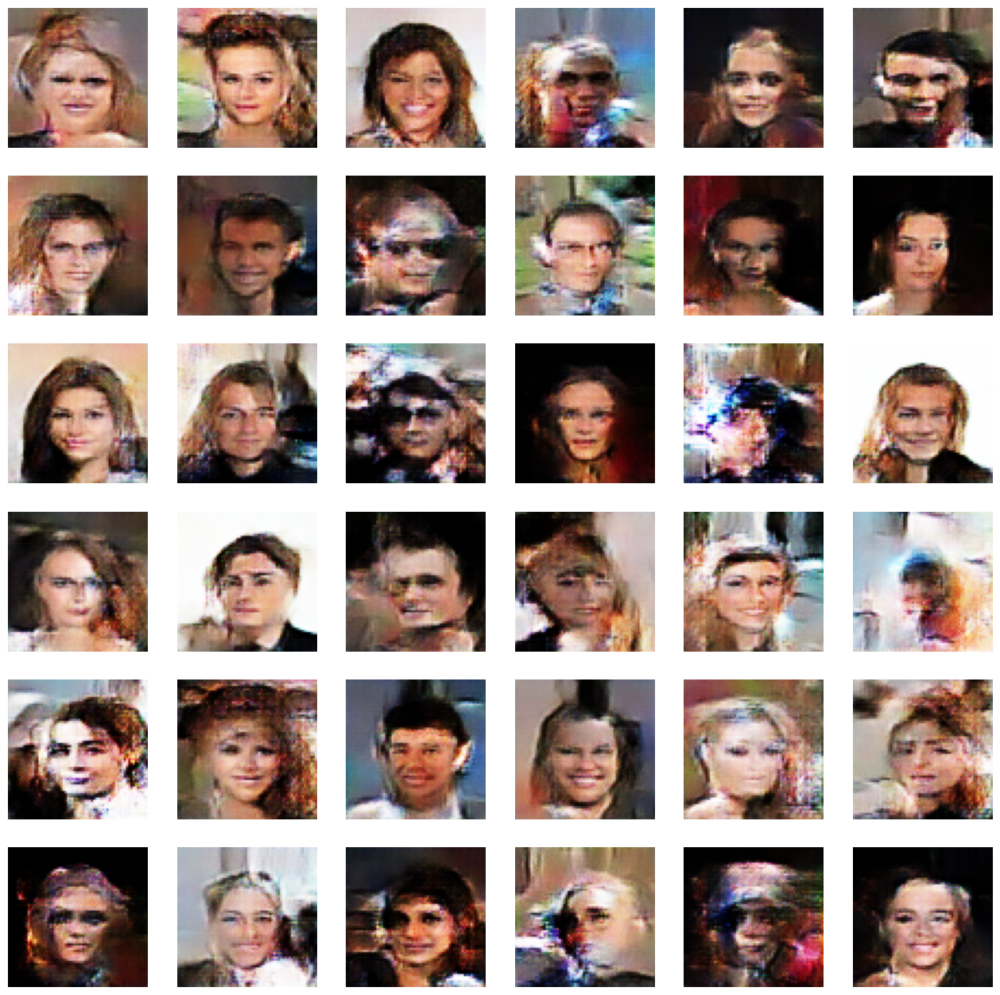

1582/1582 ━━━━━━━━━━━━━━━━━━━━ 279s 176ms/step - d_loss: 1.2122 - g_loss: 0.8480
Epoch 4/100
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 1.2236 - g_loss: 0.8225

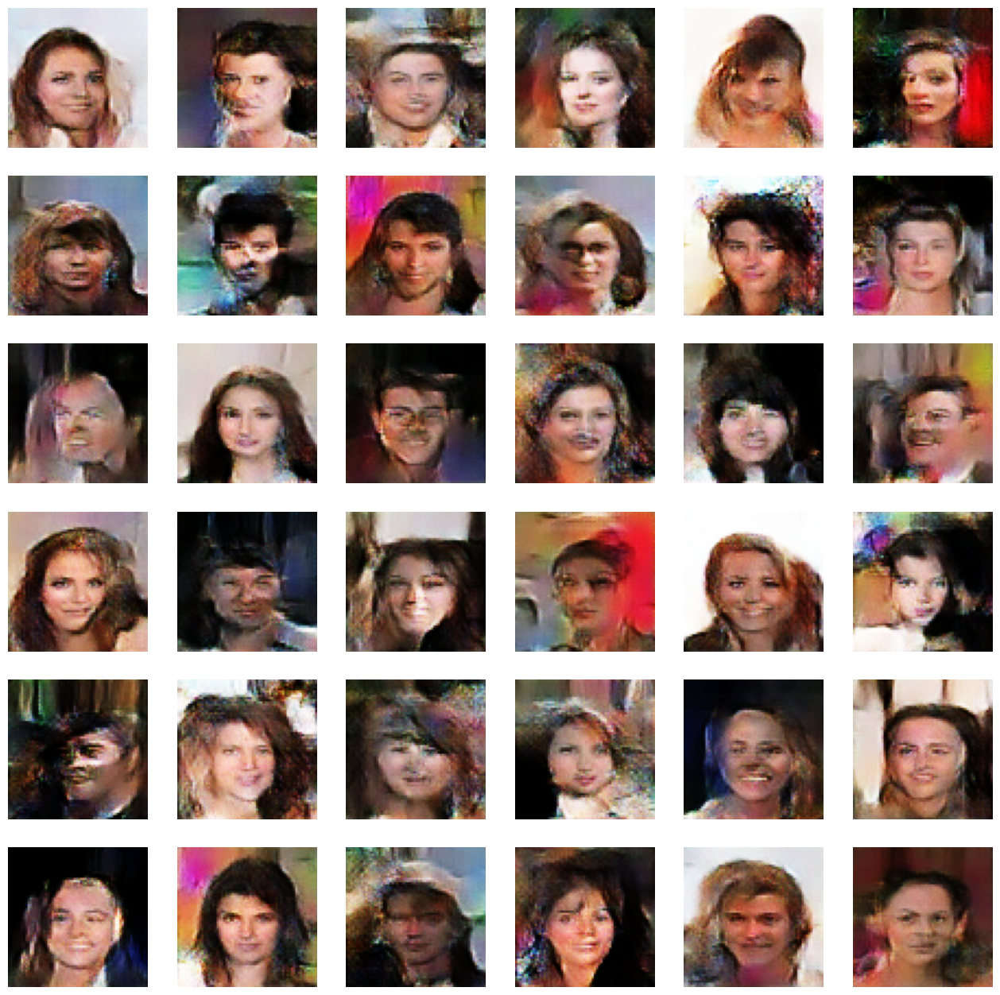

1582/1582 ━━━━━━━━━━━━━━━━━━━━ 279s 176ms/step - d_loss: 1.2236 - g_loss: 0.8225
Epoch 5/100
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 1.2288 - g_loss: 0.8211

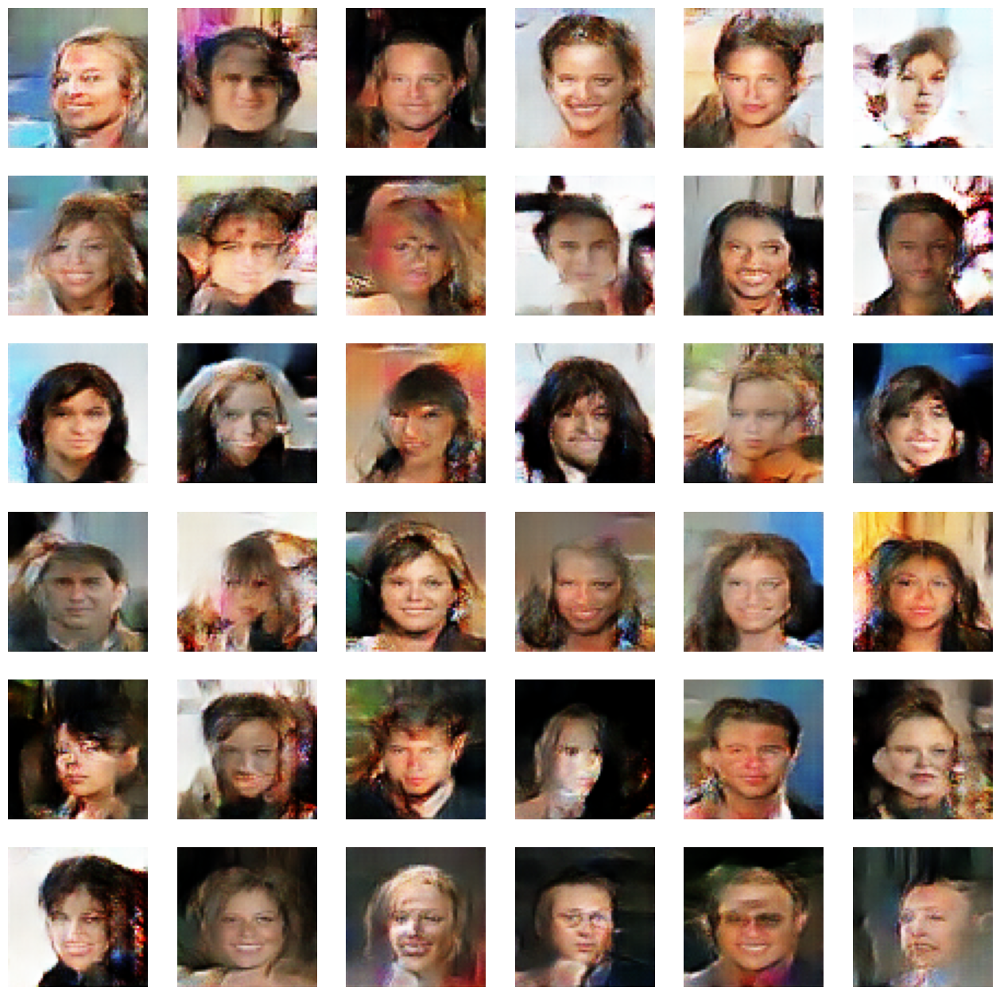

1582/1582 ━━━━━━━━━━━━━━━━━━━━ 279s 176ms/step - d_loss: 1.2288 - g_loss: 0.8211
Epoch 6/100
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 1.2218 - g_loss: 0.8285

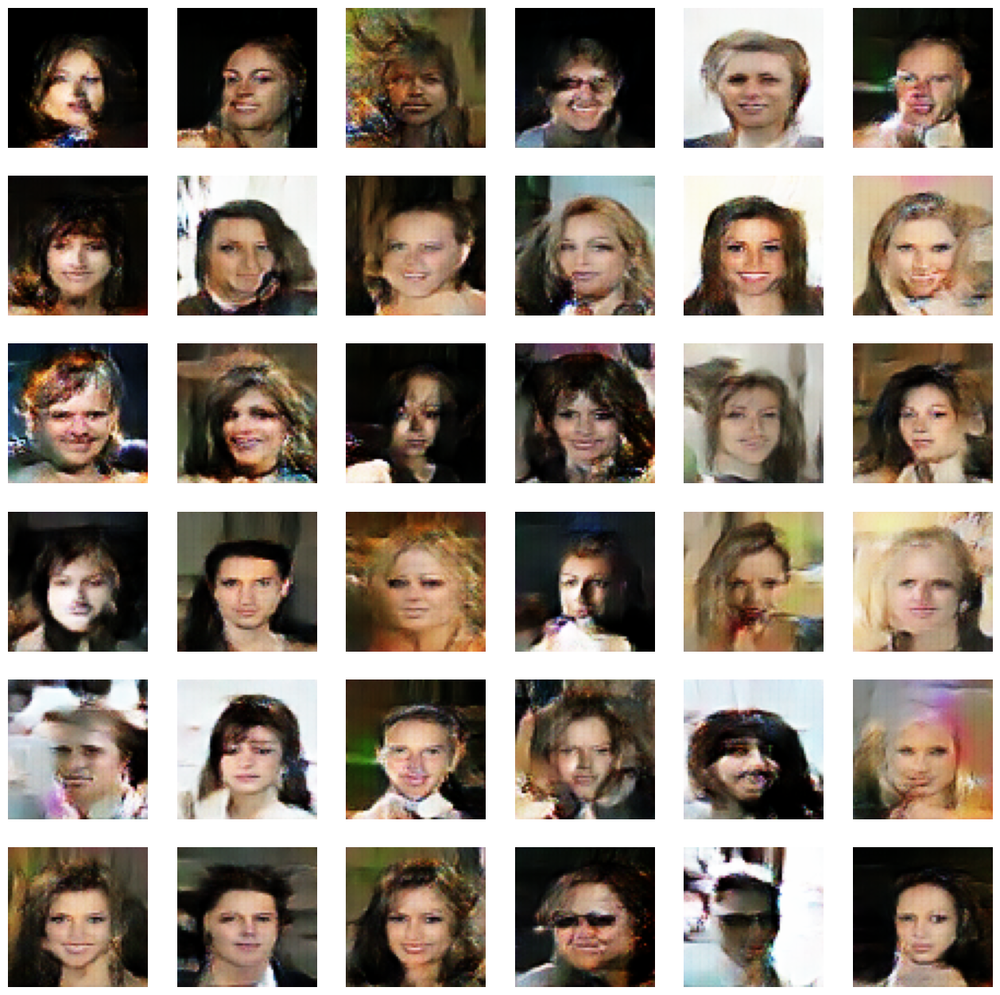

1582/1582 ━━━━━━━━━━━━━━━━━━━━ 281s 177ms/step - d_loss: 1.2218 - g_loss: 0.8285
Epoch 7/100
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - d_loss: 1.2140 - g_loss: 0.8306

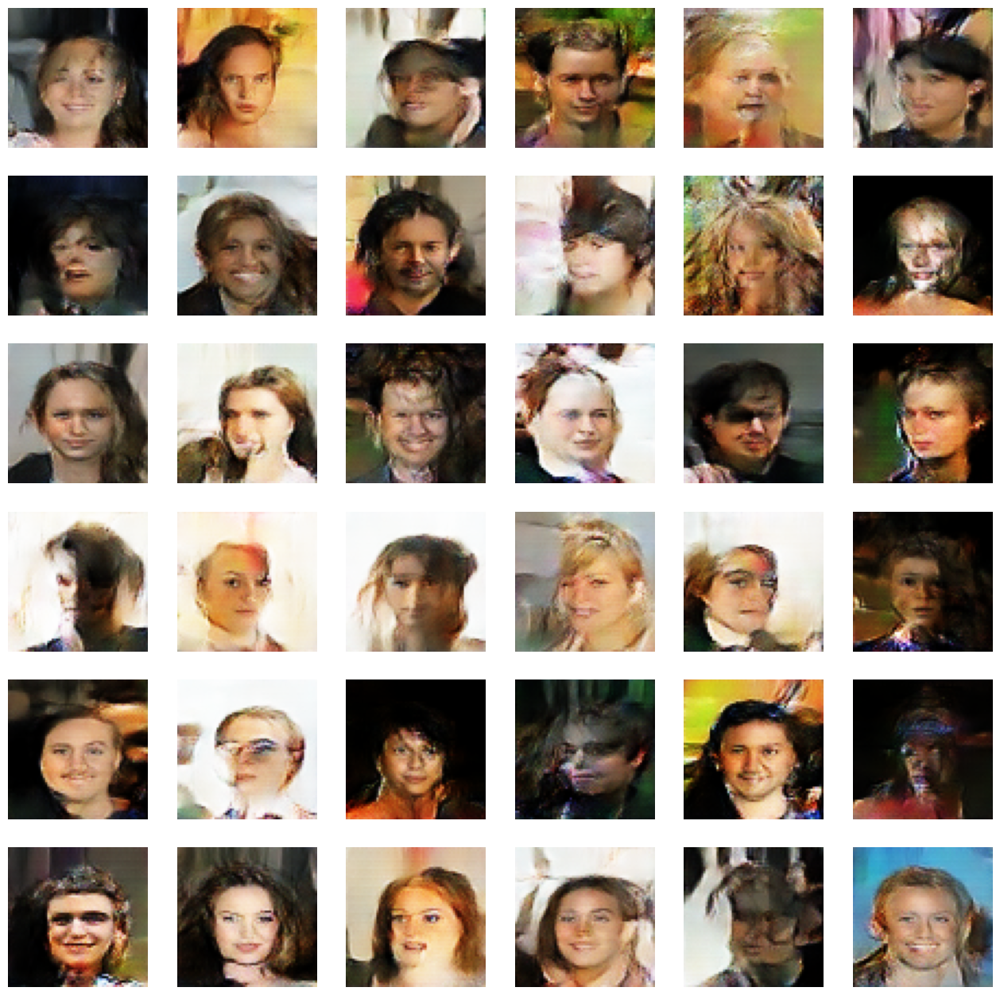

1582/1582 ━━━━━━━━━━━━━━━━━━━━ 322s 177ms/step - d_loss: 1.2140 - g_loss: 0.8306
Epoch 8/100
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 1.2290 - g_loss: 0.8313

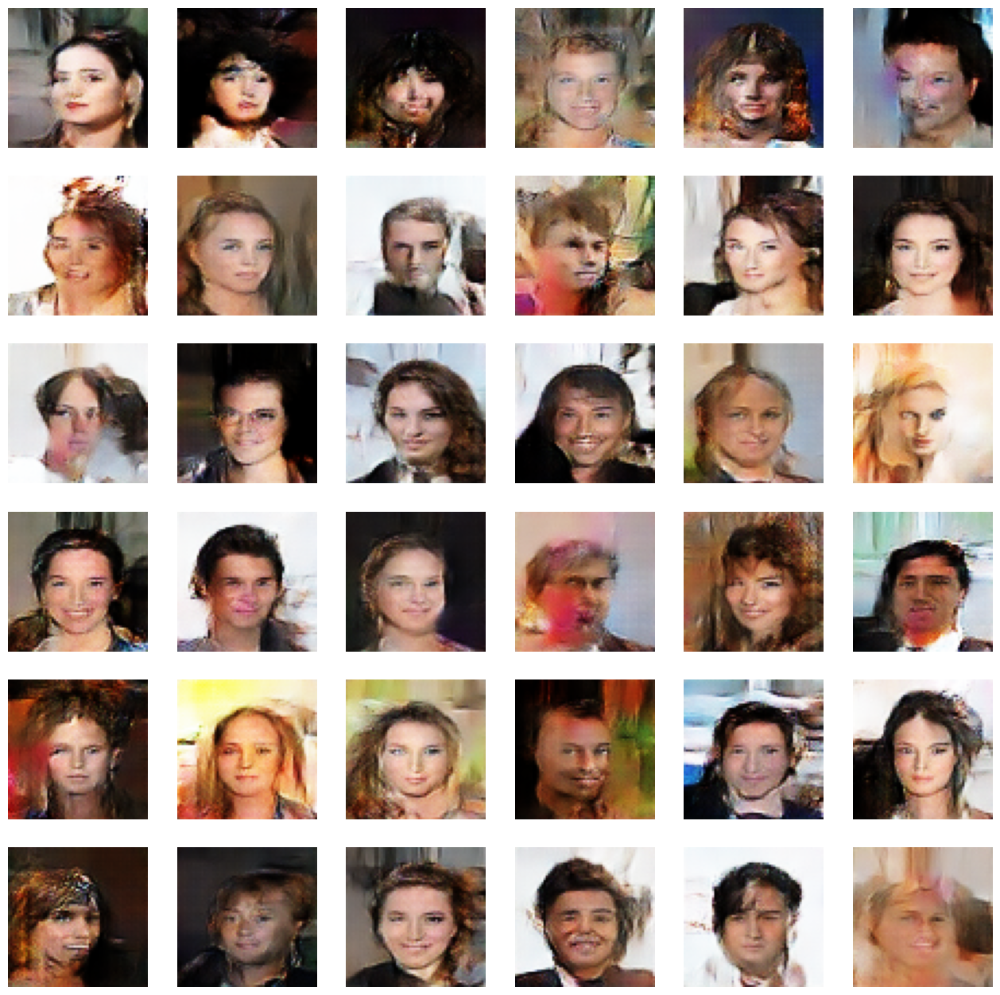

1582/1582 ━━━━━━━━━━━━━━━━━━━━ 281s 177ms/step - d_loss: 1.2290 - g_loss: 0.8313
Epoch 9/100
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 1.2168 - g_loss: 0.8387

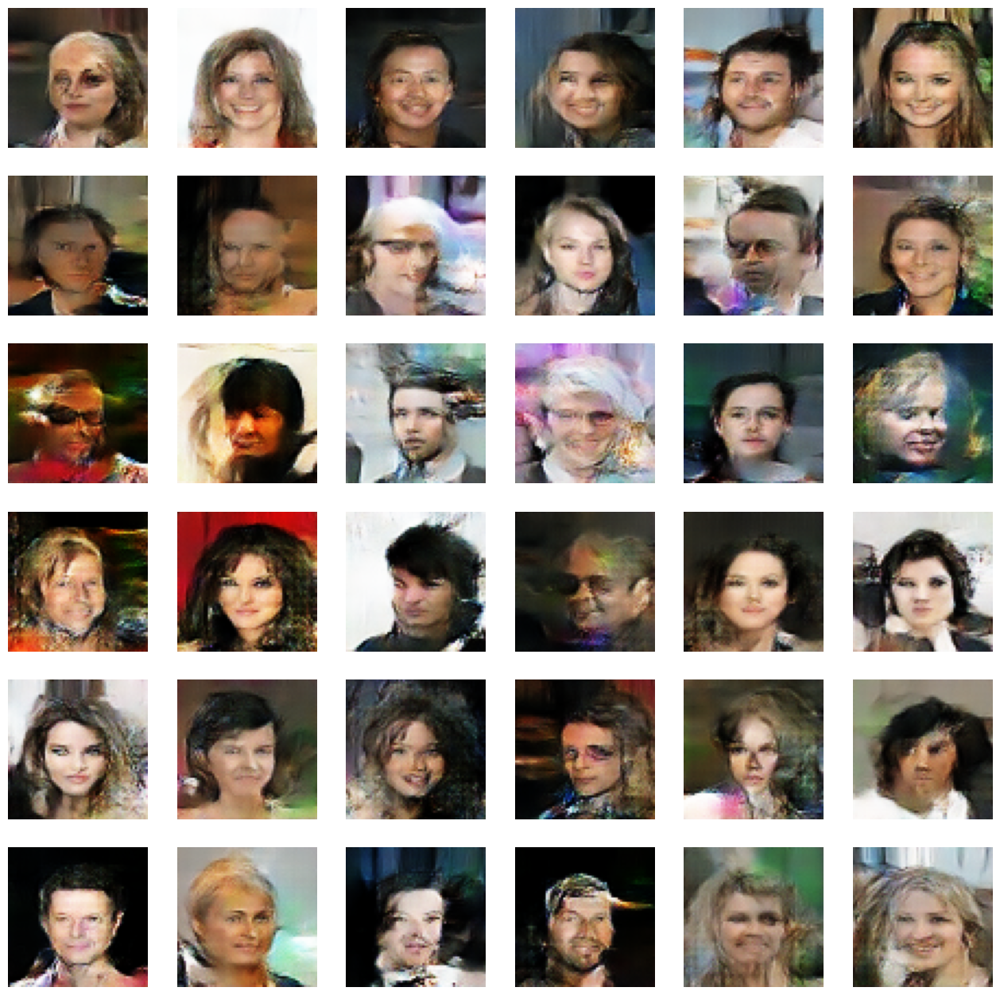

1582/1582 ━━━━━━━━━━━━━━━━━━━━ 281s 177ms/step - d_loss: 1.2168 - g_loss: 0.8387
Epoch 10/100
1582/1582 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - d_loss: 1.1993 - g_loss: 0.8557

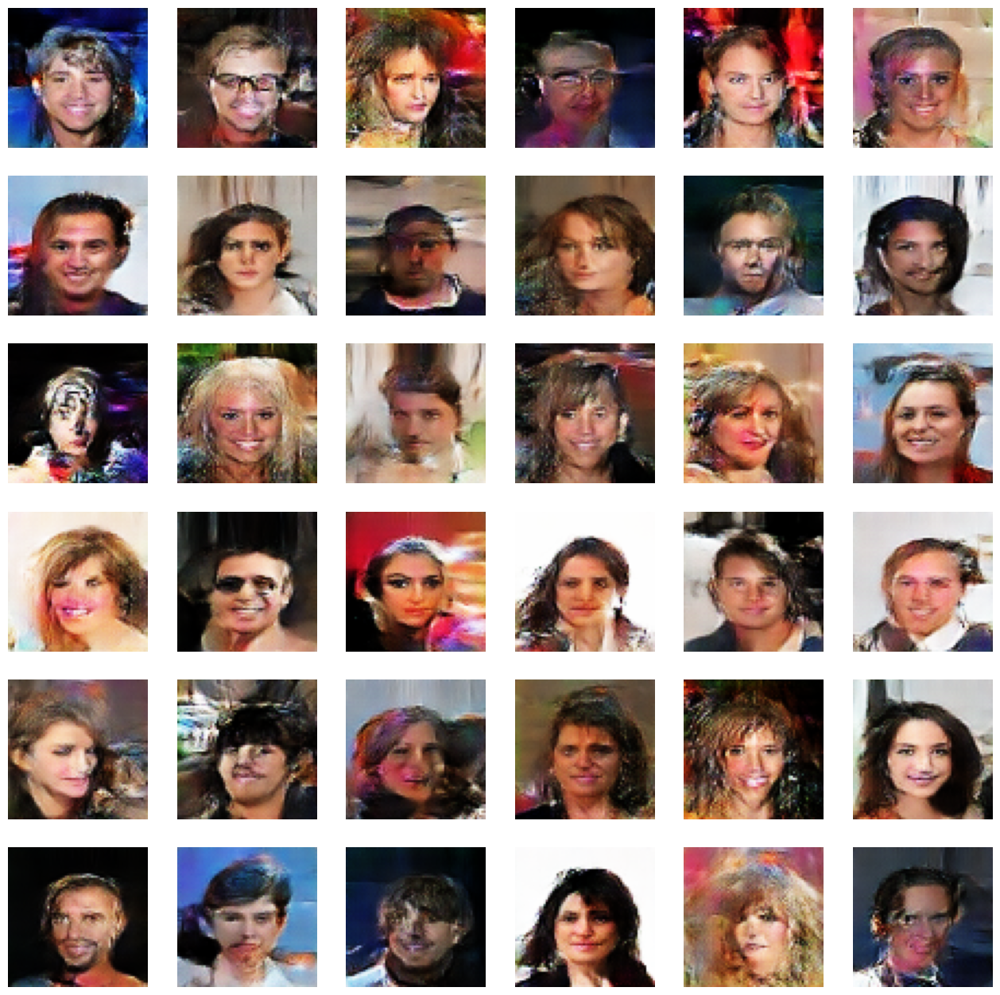

1582/1582 ━━━━━━━━━━━━━━━━━━━━ 281s 177ms/step - d_loss: 1.1993 - g_loss: 0.8557
Epoch 11/100
  69/1582 ━━━━━━━━━━━━━━━━━━━━ 4:24 175ms/step - d_loss: 1.1914 - g_loss: 0.8663

In [ ]:
history = gan.fit(train_data, epochs=100, callbacks=[GANMonitor(latent_dim=l_dim)])